# Predicting Poverty Levels 
### Costa Rican Household Poverty Level Prediction
In order to reduce poverty,social inequalities and address the needs of small and vulnerable countries, we must identify which households have the highest need for social welfare assistance? We’re told that often the most needy won’t be able to provide the documentation required of formal applications, so in many ways those who need the most help are also those who are least likely to recieve it.
In this project, I will develop a model to help identify individuals and households that have the greatest need of financial aid. The challenge here then is to use the other information we know about individuals and households - features such as their family size, home construction type and their access to adequate sanitation - to help identify those individuals most in need before it’s too late.
For this project, i will use Costa Rican Household Poverty Level Prediction dataset from the Inter-American Development Bank available on [kaggle](https://www.kaggle.com/c/costa-rican-household-poverty-prediction/data?select=train.csv).


In [2]:
# Load libraries

library(tidyverse) # importing, cleaning, visualising
library(xgboost) # gradient boosted machines
library(caret) # ml pipelines made easy
library(VIM) # missing data
library(corrplot) # correlation visualisation
library(ggthemes) # extra plotting themes
library(plotly) # interactive plots
library(factoextra) # pca visualisation
library(Rtsne) # visualisation of high dimensional datsets
library(largeVis) # visualisation of high dimensional datsets
library(breakDown) # visualising model results
library(gridExtra) # arranging plots
library(lightgbm) # leaf-wise gbm
library(glmnet) # regularised regression

# Disable scientific notation

options(scipen = 999)


Warning message:
"package 'tidyverse' was built under R version 3.6.3"
-- Attaching packages --------------------------------------- tidyverse 1.3.0 --

v ggplot2 3.3.2     v purrr   0.3.4
v tibble  3.0.3     v dplyr   1.0.2
v tidyr   1.1.2     v stringr 1.4.0
v readr   1.3.1     v forcats 0.5.0

Warning message:
"package 'ggplot2' was built under R version 3.6.3"
Warning message:
"package 'tibble' was built under R version 3.6.3"
Warning message:
"package 'tidyr' was built under R version 3.6.3"
Warning message:
"package 'readr' was built under R version 3.6.3"
Warning message:
"package 'purrr' was built under R version 3.6.3"
Warning message:
"package 'dplyr' was built under R version 3.6.3"
Warning message:
"package 'stringr' was built under R version 3.6.3"
Warning message:
"package 'forcats' was built under R version 3.6.3"
-- Conflicts ------------------------------------------ tidyverse_conflicts() --
x dplyr::filter() masks stats::filter()
x dplyr::lag()    masks stats::lag()



ERROR: Error in library(largeVis): there is no package called 'largeVis'


In [4]:
# function for macro F1 score evaluation

evalerror <- function(preds, dtrain) {
    
  preds = matrix(preds, ncol = 4, byrow = TRUE)
  preds = apply(preds, 1, which.max)-1
  preds = factor(preds, levels = c(0,1,2,3))
  
  labels <- factor(getinfo(dtrain, "label"), levels = c(0,1,2,3))
  cm = confusionMatrix(data = preds, reference = labels)$table

  precision <- diag(cm) / colSums(cm)
  recall <- diag(cm) / rowSums(cm)
  
  f1 <-  ifelse(precision + recall == 0, 0, 2 * precision * recall / (precision + recall))
  f1[is.na(f1)] <- 0
  
  err = ifelse(nlevels(labels) == 2, f1[1], mean(f1))
    return(list(metric = "f1_score", value = err))
  
}

In [6]:
# Import data

train = read_csv("C:\\Users\\wikie\\Documents\\Datasets\\costarica\\train.csv")
test = read_csv("C:\\Users\\wikie\\Documents\\Datasets\\costarica\\test.csv")

cat("Train dimensions: ", dim(train))


Parsed with column specification:
cols(
  .default = col_double(),
  Id = col_character(),
  idhogar = col_character(),
  dependency = col_character(),
  edjefe = col_character(),
  edjefa = col_character()
)

See spec(...) for full column specifications.

Parsed with column specification:
cols(
  .default = col_double(),
  Id = col_character(),
  idhogar = col_character(),
  dependency = col_character(),
  edjefe = col_character(),
  edjefa = col_character()
)

See spec(...) for full column specifications.



Train dimensions:  9557 143

In [7]:
cat("Test dimensions: ", dim(test))

Test dimensions:  23856 142

In [8]:
head(train)

Id,v2a1,hacdor,rooms,hacapo,v14a,refrig,v18q,v18q1,r4h1,...,SQBescolari,SQBage,SQBhogar_total,SQBedjefe,SQBhogar_nin,SQBovercrowding,SQBdependency,SQBmeaned,agesq,Target
ID_279628684,190000,0,3,0,1,1,0,NA,0,...,100,1849,1,100,0,1.000000,0,100,1849,4
ID_f29eb3ddd,135000,0,4,0,1,1,1,1,0,...,144,4489,1,144,0,1.000000,64,144,4489,4
ID_68de51c94,NA,0,8,0,1,1,0,NA,0,...,121,8464,1,0,0,0.250000,64,121,8464,4
ID_d671db89c,180000,0,5,0,1,1,1,1,0,...,81,289,16,121,4,1.777778,1,121,289,4
ID_d56d6f5f5,180000,0,5,0,1,1,1,1,0,...,121,1369,16,121,4,1.777778,1,121,1369,4
ID_ec05b1a7b,180000,0,5,0,1,1,1,1,0,...,121,1444,16,121,4,1.777778,1,121,1444,4


One of the first things I notice here is that everything has already been one-hot encoded. Since I don’t know a priori whether this is the best approach I think it will be worth investigating other methods to encode the categorical information.

It’s also important to note that the test set is much larger than the training set (almost 2.5x!) and that the latter is actually quite small for a task such as this. This immediately makes me think two things:

1. Regularisation and model diversity will be key for getting good results
2. There may be opportunities for unsupervised learning on the full dataset to improve the generalisability of our models

### Categorical Data
Let’s start by reconstructing some of the one-hot encoded features. I will also generate an integer encoding of the categorical features: while they may not be ordered and distances between levels meaningful in any sense, integer encoding can still prove to be useful for certain problems. Since we’re planning to use a GBM, I’m not too concerned about introducing redundant features.

In [9]:
# Categorical data ---------------------------------------------------------------------

# Combine data before reversing

full = as_tibble(rbind(train %>% select(-Target), test))

# Create a list of the features names that need to be reverse engineered

feature_list = c(
  "pared",
  "piso",
  "techo",
  "abasta",
  "sanitario",
  "energcocinar",
  "elimbasu",
  "epared",
  "etecho",
  "eviv",
  "estadocivil",
  "parentesco",
  "instlevel",
  "tipovivi",
  "lugar",
  "area"
)

# Matrix to store our new features

new_features_integer = data.frame(matrix(ncol = length(feature_list), nrow = nrow(full)))

# Cycle through and reverse the OHE process for these

ohe_names = vector()

for(i in 1:length(feature_list)){
  
  # Grab the feature
  
  feature_to_fix = full %>% select(starts_with(feature_list[i]))
  
  # Fix and enter into our new feature matrix
  
  new_features_integer[,i] = as.integer(factor(names(feature_to_fix)[max.col(feature_to_fix)], ordered = FALSE))
  names(new_features_integer)[i] = paste0(feature_list[i],"_int")
    
    ohe_names = c(ohe_names, as.vector(names(feature_to_fix)))
  
}

head(new_features_integer)

pared_int,piso_int,techo_int,abasta_int,sanitario_int,energcocinar_int,elimbasu_int,epared_int,etecho_int,eviv_int,estadocivil_int,parentesco_int,instlevel_int,tipovivi_int,lugar_int,area_int
1,3,2,1,2,3,1,2,1,1,4,1,4,3,1,1
4,2,4,1,2,2,1,2,2,2,4,1,8,3,1,1
4,3,4,1,2,2,1,2,3,3,6,1,5,1,1,1
1,3,4,1,2,2,1,3,3,3,7,6,4,3,1,1
1,3,4,1,2,2,1,3,3,3,2,5,5,3,1,1
1,3,4,1,2,2,1,3,3,3,2,1,5,3,1,1


In [10]:
full = data.frame(cbind(full,new_features_integer), stringsAsFactors = FALSE)

### Ridge Encoding
Let’s try encoding the categorical information in a more meaningful way. The idea will be to used ridge regression with just the categorical features to find a set of coefficients that have been appropriately regularised so as to not overfit to the response in question. Using these coeffecients as features instead of the original categorical data introduces a label-based ordering that is more robust than standard label encoding.

To create just a single set of coeffecients and try and restrict any overfitting, I will simplify the task initially and classify households into “vunerable” and “non-vunerable”. Throughout this work book it has become clear that this seperation is really not too difficult, and that it is the fine grained distinct between the vunerable that is difficult.

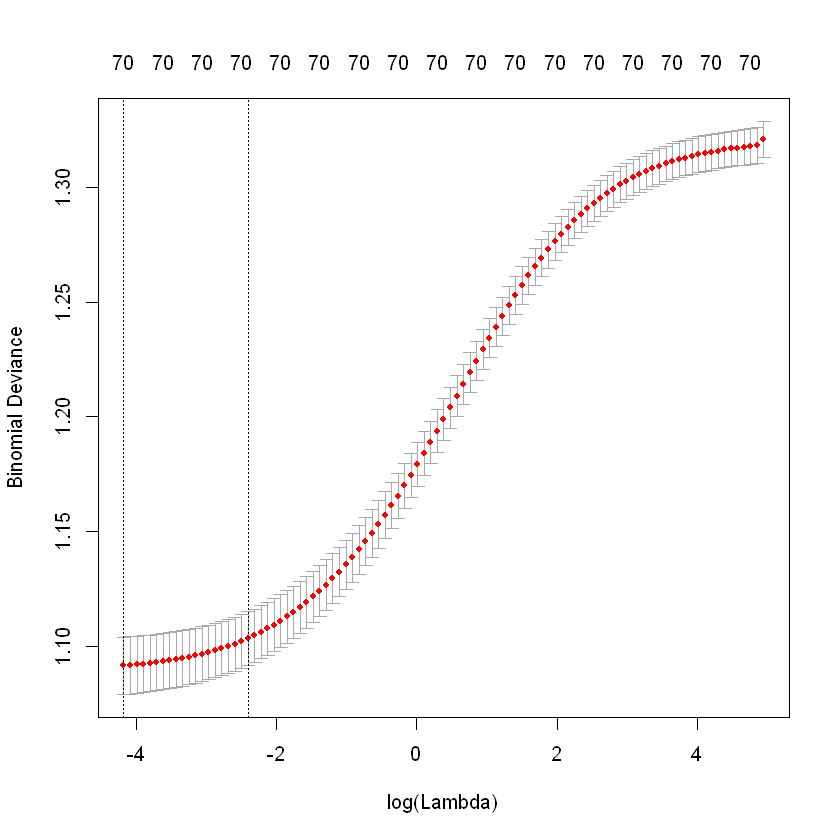

In [13]:
# Grab OHE features

new_features_integer = data.frame(apply(new_features_integer,2,factor))
ridge_features = model.matrix(~.-1,new_features_integer[1:nrow(train),])
ridge_response = ifelse(train$Target == 4, 0, 1)


# Run ridge

cv.fit = cv.glmnet(
    x = as.matrix(ridge_features),
    y = as.factor(ridge_response),
    nfolds = 5,
    alpha = 0,
    family = "binomial"
)

plot(cv.fit)

In [14]:
# Rather than taking the predictions themselves, I will take the coeffecients as my encoding

tmp_coeffs = coef(cv.fit, s = "lambda.min")
coefs = data.frame(name = tmp_coeffs@Dimnames[[1]][tmp_coeffs@i + 1], coefficient = tmp_coeffs@x)


# Lookup

# Adjust original feature level names

for (i in 1:ncol(new_features_integer)){
  new_features_integer[,i] = paste0(names(new_features_integer)[i], new_features_integer[,i])
}
new_features_ridge <- new_features_integer
new_features_ridge[] <- coefs$coefficient[match(unlist(new_features_integer), coefs$name)]

# Zeros can replace the NA since these are just base level

new_features_ridge[is.na(new_features_ridge)] = 0

# Rename for now ...

names(new_features_ridge) = gsub("int","ridge",names(new_features_ridge))

# Attach to data

full = data.frame(cbind(full,new_features_ridge), stringsAsFactors = FALSE)


For the moment we will take the lambda with the lowest c.v. error as our selected model. Hopefully the resulting encoding will be more useful to our tree-based modelling approach than OHE or plain old integer encoding, as it should allow for some divisions of the data that would otherwise require mutliple splits.

### Visualisations
Let’s explore the data and try and develop a good understanding of what we’re working with. This is also an opportunity to show off some of the great plotting capabilities within R.

Note: this section of the kernel is still under development, so check back for more visualisations soon!

### Missing data
As a first step, let’s see how much missing data we’re dealing with:

Missing data found in  2.873563 % of features

Warning message in plot.aggr(res, ...):
"not enough horizontal space to display frequencies"


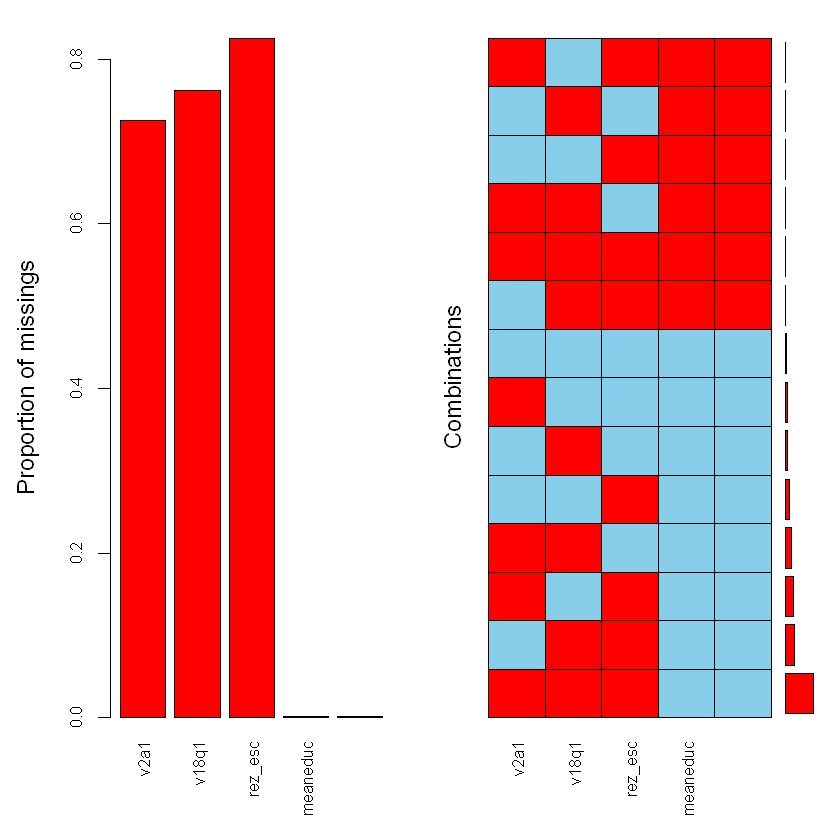

In [15]:
# Filter the data for those features that actually have some missing data

full_missing = full[, sapply(full, anyNA), drop = FALSE]

cat("Missing data found in ", ncol(full_missing)/ncol(full)*100, "% of features")
## Missing data found in  2.873563 % of features
# Plot missing information for these features

aggr(full_missing, prop = T, numbers = T, cex.axis = 0.8)

In [16]:
# Add a feature to full indicating the number of missing entries for an observation

missing_feature = apply(full, 1, function(x){sum(is.na(x))})
full = full %>% cbind(missing_feature)

It appears that we have very little missing data in this dataset: only 3% of our features have any missing data, though clearly for the first three above more is missing than is present. As a reminder, these features were:

- v2a1, Monthly rent payment
- v18q1, number of tablets household owns
- rez_esc, Years behind in school

It’s a shame these have such limited information, especially for monthly rent: I feel this feature could be really helpful for identifying struggling households when combined with information about the number of children, education, etc.

Overall though it doesn’t look like missing data will be a big issue for this project. We’ll add a feature containing row-wise counts of NAs, just in case there is something informative in the missing patterns.

### Correlations
Let’s have a look at the correlation matrix for the numerical features after removing the encoded categoricals (OHE/integer) and the three features recognised above as mostly missing:



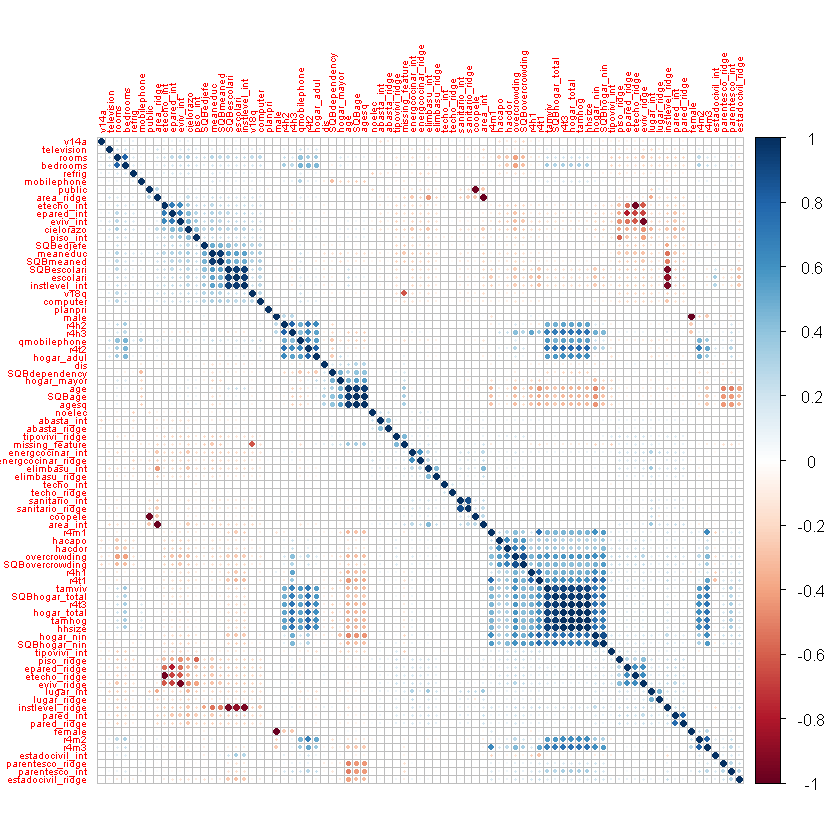

In [17]:
# Select numeric features (removing the categorical features for now and those with high % NA)

full_numerical = full %>% 
  select_if(is.numeric) %>% 
  select(-one_of(ohe_names)) %>% 
  select(
    -v2a1,
    -v18q1,
    -rez_esc
  )

# Since the number of NA is so low for the remaining features I will just replace them with their column mean

replace_na = function(x) replace(x, is.na(x), mean(x, na.rm = TRUE))
full_numerical = apply(full_numerical, 2, replace_na)

# Create the matrix

full_numerical_cor = cor(full_numerical, use = "complete.obs")

# Plot the matrix with some clustering

corrplot(full_numerical_cor, order = "hclust", tl.cex = 0.5)

Some clear correlated feature groups emerge here, for example there is a large cluster of similar or identical features describing household size. This suggests to me that PCA or some other unsupervised dimensionality reduction techniques could be of benefit in the model, especially considering that the test set is so large relative to the training set. Let’s explore this option briefly and see what we can find.

### PCA
Large groups of correlated features? Let’s try Principal Component Analysis (PCA)!



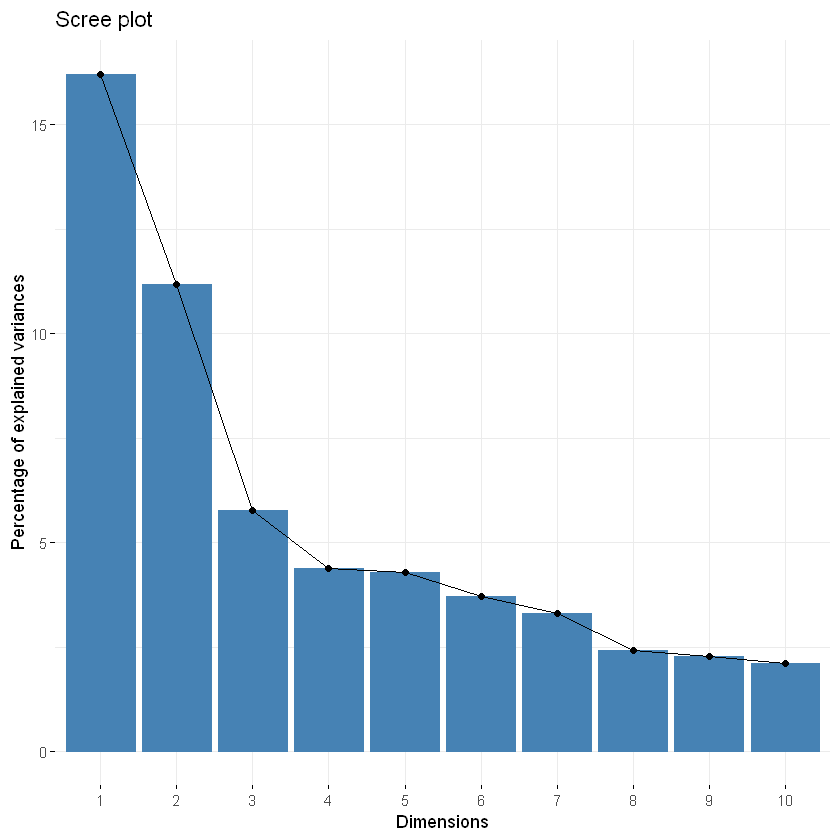

In [19]:
# We have already created a numerical matrix with the categorical information excluded, so we will use this

full_pca = prcomp(full_numerical, center = TRUE, scale. = TRUE)

full = full %>% 
  cbind(full_pca$x[,1:3])

# scree plot

fviz_eig(full_pca)

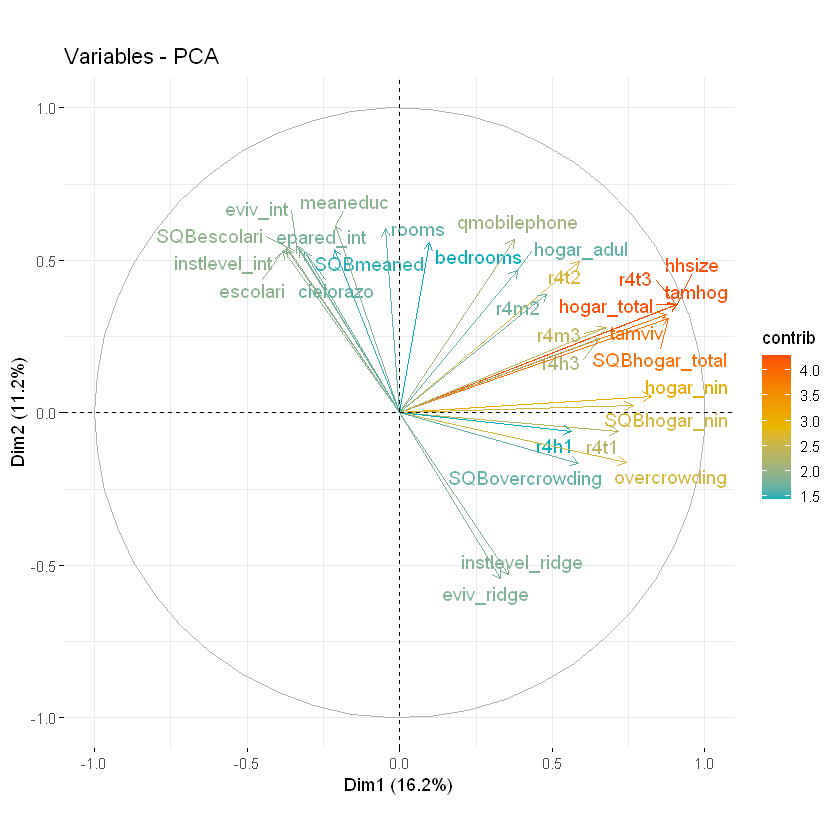

In [20]:
# plot first two components

fviz_pca_var(full_pca,
             col.var = "contrib", # Color by contributions to the PC
             gradient.cols = c("#00AFBB", "#E7B800", "#FC4E07"),
             select.var = list(contrib = 30), # top 30 contributing
             repel = TRUE     # Avoid text overlapping
             )

We get the result that 30.2% of the original variance is explained by taking just the first two components, confirming what we saw in the correlation matrix. Features describing household size have larger loadings across PC1, with large values for the most overcrowded households. Across the second dimension, we see more information about education and years of schooling coming out. Both of these dimensions strike me as important for determining a households vunerability levels (education is especially important, as we will see).

For the purposes of feature engineering, I’ll take the first 10 or so components, and include these in the model.

Out of interest, let’s take just the training set and visualise our target values in PCA-space (2d):



In [21]:
# Grab training set for visualisation

train_pca = full[1:nrow(train),] %>% 
  select(PC1,PC2,PC3) %>% 
  cbind(train$Target) %>% 
  rename(Target = `train$Target`) %>% 
  mutate(
    Target = as.factor(Target),
    Target_Binary = ifelse(Target == 4, "Non-vunerable", "Vunerable"))

# Plot

plot_ly(train_pca, x = ~PC1, y = ~PC2, z = ~PC3, color = ~Target) %>%
  add_markers(marker = list(
      size = 3,
      opacity = 0.5)) %>%
  layout(scene = list(xaxis = list(title = 'PC1'),
                     yaxis = list(title = 'PC2'),
                     zaxis = list(title = 'PC3'),
         title = 'PCA plot (original target)'))

Warning message:
"`arrange_()` is deprecated as of dplyr 0.7.0.
Please use `arrange()` instead.
See vignette('programming') for more help
This warning is displayed once every 8 hours.
Call `lifecycle::last_warnings()` to see where this warning was generated."


HTML widgets cannot be represented in plain text (need html)

In [22]:
plot_ly(train_pca, x = ~PC1, y = ~PC2, z = ~PC3, color = ~Target_Binary) %>%
  add_markers(marker = list(
      size = 3,
      opacity = 0.5)) %>%
  layout(scene = list(xaxis = list(title = 'PC1'),
                     yaxis = list(title = 'PC2'),
                     zaxis = list(title = 'PC3'),
         title = 'PCA plot (binary target)'))

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"


HTML widgets cannot be represented in plain text (need html)

Seems our target group 1 (“extreme poverty”) and 2 (“moderate poverty”) appear to have some degree of separation at the extremeties, but only for a relatively small number of points.

Also, along PC2 there does appear to be quite a strong seperation of vunerable and non-vunerable: this feature might prove to be fairly important for our classification model.

Let’s dig a bit deeper into the underlying structure of the training data using a couple of methods for visualising higher dimensional datasets.

### t-SNE
t-SNE (t-Distributed Stochastic Neighbor Embedding) is a fantastic way of visualising high dimensional data sets in 2 or 3 dimensions. In essence, it attempts to retain the proximity of points in the higher dimensional space such that neighbouring points in the p-dimensional space appear closer together in our 2d or 3d representation.

In [23]:
# Run tsne on sample of numerical features we used for PCA (training set only)

train_tsne = full_numerical[1:nrow(train),] 

# Appears we have duplicates in our data - let's look

train_duplicates = which(duplicated(train_tsne))

# 23 instances: I suppose this could happen since we may have two adults in the same house with all numerical features being identical

# Remove dupes and scale

train_tsne_deduped = train_tsne[-train_duplicates,]
train_tsne_labels = train[-train_duplicates, "Target"]
train_tsne_labels = as.factor(train_tsne_labels$Target)

In [24]:
# Let's also include a binary version of our target to make visualisation easier

train_tsne_labels_binary = train[-train_duplicates, "Target"] %>% 
  mutate(
    Target_Binary = ifelse(Target == 4, "Non-vunerable", "Vunerable")
  )
train_tsne_labels_binary = as.factor(train_tsne_labels_binary$Target_Binary)

tsne = Rtsne(
  train_tsne_deduped, 
  dims = 3, 
  perplexity = 50, 
  max_iter = 500, 
  verbose = TRUE, 
  theta = 0.35,
  pca_scale = TRUE)

Performing PCA
Read the 9543 x 50 data matrix successfully!
OpenMP is working. 1 threads.
Using no_dims = 3, perplexity = 50.000000, and theta = 0.350000
Computing input similarities...
Building tree...
Done in 24.18 seconds (sparsity = 0.024102)!
Learning embedding...
Iteration 50: error is 90.373166 (50 iterations in 17.25 seconds)
Iteration 100: error is 90.269559 (50 iterations in 24.07 seconds)
Iteration 150: error is 89.015071 (50 iterations in 16.78 seconds)
Iteration 200: error is 88.905375 (50 iterations in 12.38 seconds)
Iteration 250: error is 88.900952 (50 iterations in 11.88 seconds)
Iteration 300: error is 2.975823 (50 iterations in 10.51 seconds)
Iteration 350: error is 2.553257 (50 iterations in 9.93 seconds)
Iteration 400: error is 2.335911 (50 iterations in 9.65 seconds)
Iteration 450: error is 2.197095 (50 iterations in 9.75 seconds)
Iteration 500: error is 2.097873 (50 iterations in 9.43 seconds)
Fitting performed in 131.61 seconds.


In [25]:
# Plot with all labels 

tsne_plot <- data.frame(x = tsne$Y[,1], y = tsne$Y[,2], z = tsne$Y[,3], Target = train_tsne_labels)

plot_ly(tsne_plot, x =~x, y =~y, z =~z, color = ~Target) %>%
  add_markers(marker = list(
      size = 3,
      opacity = 0.5)) %>%
  layout(scene = list(xaxis = list(title = 'D1'),
                     yaxis = list(title = 'D2'),
                     zaxis = list(title = 'D3')),
         title = 't-SNE plot (original targets')

HTML widgets cannot be represented in plain text (need html)

In [26]:
# Plot with binary labels 

tsne_plot_binary <- data.frame(x = tsne$Y[,1], y = tsne$Y[,2], z = tsne$Y[,3], Target = train_tsne_labels_binary)

plot_ly(tsne_plot_binary, x =~x, y =~y, z =~z, color = ~Target) %>%
  add_markers(marker = list(
      size = 3,
      opacity = 0.5)) %>%
  layout(scene = list(xaxis = list(title = 'D1'),
                     yaxis = list(title = 'D2'),
                     zaxis = list(title = 'D3')),
         title = 't-SNE plot (binary target)')

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
"minimal value for n is 3, returning requested palette with 3 different levels
"


HTML widgets cannot be represented in plain text (need html)

There does appear to be some structure present in the data with some clusters where the non-vunerable customers (target = 4) seem fairly segmented.

Distinguishing between the vunerable customers (target = {1,2,3}) may prove to be fairly difficult however as there doesn’t appear to be anything leaping out. Our initial models may do “well” by trying to seperate target = 4, as this is by far the most frequent observation.



### Feature Plots
Let’s have a look at some plots of some of the features that have proved to be important in earlier versions of this kernel. We’ll take the top six important features as ranked in terms of gain for our simple XGBoost model

Warning message:
"Problem with `mutate()` input `dependency`.
i argument is not numeric or logical: returning NA
i Input `dependency` is `as.numeric(...)`."
Warning message in mean.default(dependency, na.rm = TRUE):
"argument is not numeric or logical: returning NA"


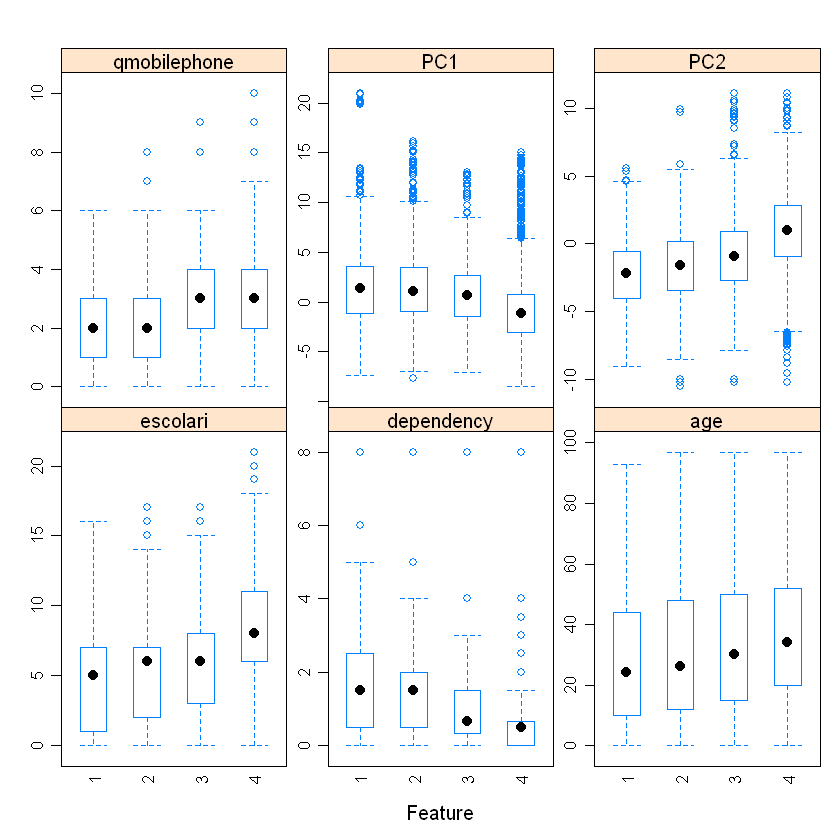

In [32]:
# Select features

important_features = c(
  "escolari",
  "dependency",
  "age",
  "qmobilephone",
  "PC1",
  "PC2"
)

important = full[1:nrow(train),] %>% cbind(train$Target) %>%
  rename(Target = `train$Target`) %>% 
  select(one_of(important_features), Target) %>% 
  mutate(    
    dependency = as.numeric(ifelse(dependency == 'no', 0, 
                                   ifelse(dependency == 'yes', mean(dependency, na.rm = TRUE), dependency)))
    )
featurePlot(x=important[,1:6], y=as.factor(important[,7]),            
            plot = "box", 
            scales = list(y = list(relation="free"),
                          x = list(rot = 90)),  
            layout = c(3, 2), 
            auto.key = list(columns = 3))

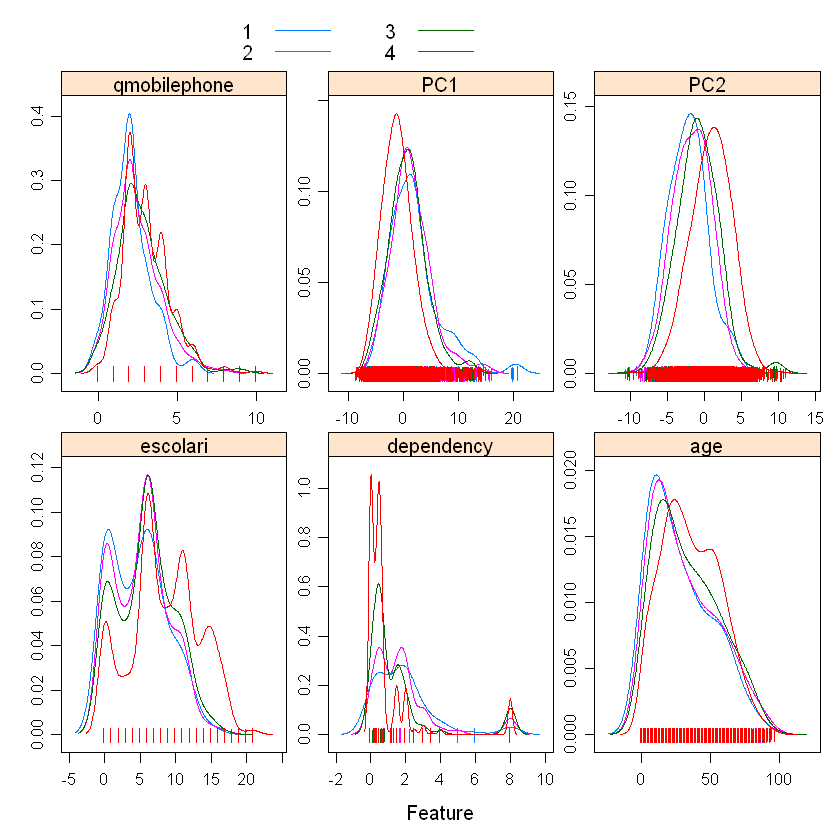

In [33]:
featurePlot(x=important[,1:6], y=as.factor(important[,7]),            
            plot = "density", 
            scales = list(x = list(relation="free"), 
                          y = list(relation="free")), 
            adjust = 1.5, 
            pch = "|", 
            layout = c(3, 2), 
            auto.key = list(columns = 3))

Vunerable households appear to be much younger with less years of schooling. There appears to be some clear seperation of the most vunerable along PC2, which we see is heavily influenced by age. Interestingly there’s a number of the poorest at the highest extreme values of PC1, though it isn’t many.

In most cases we see the the non-vunerable households are easily distinguished from the vunerable, but that it is the granularity of the latter that is hard to determine (as a side note, a binary classifier for vunerable / non-vunerable can achieve >98% accuracy).

Let’s check the train and test distributions for these same features to see if we notice any major differences.

Warning message:
"Problem with `mutate()` input `dependency`.
i argument is not numeric or logical: returning NA
i Input `dependency` is `as.numeric(...)`."
Warning message in mean.default(dependency, na.rm = TRUE):
"argument is not numeric or logical: returning NA"
Warning message in draw.key(simpleKey(...), draw = FALSE):
"not enough rows for columns"


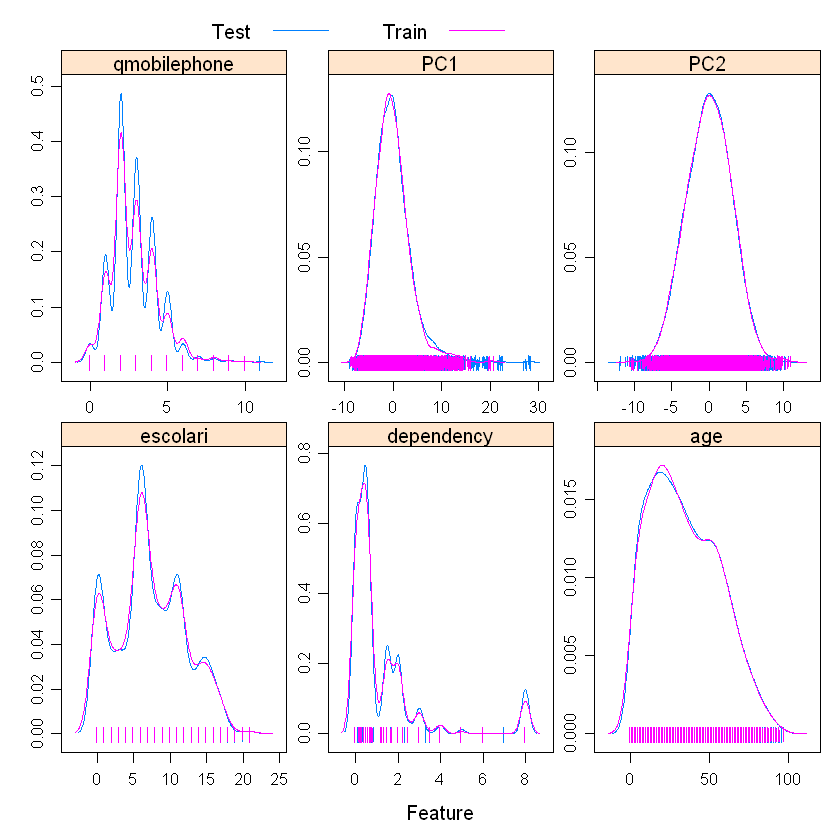

In [34]:
# Add split label

train_test_data = full %>% select(one_of(important_features)) %>% 
    mutate(    
    dependency = as.numeric(ifelse(dependency == 'no', 0, 
                                   ifelse(dependency == 'yes', mean(dependency, na.rm = TRUE), dependency)))
    )
train_test_data[1:nrow(train),"Split"] = "Train"
train_test_data[(nrow(train)+1):nrow(train_test_data),"Split"] = "Test"


# Have a look at the different distributions
featurePlot(x=train_test_data[,important_features], y=as.factor(train_test_data[,"Split"]),            
            plot = "density", 
            scales = list(x = list(relation="free"), 
                          y = list(relation="free")), 
            adjust = 1.5, 
            pch = "|", 
            layout = c(3, 2), 
            auto.key = list(columns = 3))

The distributions don’t seem to differ too much betweeen train and test, although it seems like for the number of mobile phones we seem to have more extreme results in the training data. I don’t think we have to worry too much about the split so it isn’t worth trying to adjust our training data to be more representative in any way.

### Feature Engineering
Time to get engineering. We already have some extra features courtesy of PCA, but we’ll also try constructing some features that we may intuitively feel indicate something about an individual’s poverty level. I have no prior domain knowledge so these will initially be based on my own thoughts. If you have any suggestions, let me know.

In this section I will also perform some aggregation at household level and area level (the idea for the latter came from https://www.kaggle.com/mlisovyi/feature-engineering-lighgbm-with-f1-macro). There are some features that it makes sense to aggregate to household level to understand e.g. the number of disabled individuals, the total or average years of education, etc. Most however already have an aggregate version in the data.

In particular, the features I choose to aggregate are:
- escolari
- rez_esc
- male
- female
- estadocivil
- parentesco
- instlevel
- age
- dis
- Years_out_of_education
- PC1-5

I wanted to include the principal components as they describe individuals along new dimensions, and it might be interesting to see how the makeup varies between households with respect to the new dimensions.

I will also look take these household level aggregates and produce summary statistics at the most granular geographical level available. What I’m interested in is seeing how each household compares to the average in their area with respect to the above features, in an attempt to get to a notion of relative deprivation. It may be that with a large amount of geographical diversity, relative impoverishment is a key indicator of the most needy families.


In [35]:
# Construct new features

full = full %>% mutate(
  
  Years_out_of_education = escolari - age,
  
  Rent_per_individual = v2a1/r4t3,
  Rent_per_child = v2a1/r4t1,
  Rent_per_over_65 = v2a1/r4t3,
  Rent_per_room = v2a1/rooms,
  Rent_per_bedrooms = v2a1/bedrooms,
  Rent_per_year_schooling = v2a1/escolari,
  
  Proportion_under_12 = r4t1/r4t3,
  Proportion_under_12_male = r4h1/r4t3,
  Proportion_under_12_female = r4m1/r4t3,
  Proportion_male = r4h3/r4t3,
  Proportion_female = r4m3/r4t3,
  
  Rooms_per_individual = rooms/r4t3,
  Rooms_per_child = rooms/r4t1,
  Rooms_per_over_65 = rooms/hogar_mayor,
  
  Tablets_per_individual = v18q1/r4t3,
  Tablets_per_child = v18q1/r4t1,
  
  Phones_per_individual = qmobilephone/r4t3,
  Phones_per_child = qmobilephone/r4t1,
  
  Years_schooling_per_individual = escolari/r4t3,
  Years_schooling_per_adult = escolari/(r4t3-r4t1),
  Years_schooling_per_child = escolari/r4t1,
  Years_schooling_per_room = escolari/rooms,
  Years_schooling_per_year_alive = escolari/age,

  Generational_difference_years_schooling = Years_schooling_per_adult/Years_schooling_per_child,
  
  Proportion_under_19 = hogar_nin/r4t3,
  Proportion_over_19 = hogar_adul/r4t3,
  Proportion_under_65 = (hogar_total-hogar_mayor)/r4t3,
  Proportion_over_65 = hogar_mayor/r4t3,
  
  Children_per_adult = hogar_nin/hogar_adul,
  Children_under_12_per_adult = r4t1/hogar_adul,
  Over_65_per_adult = hogar_mayor/hogar_adul,
  
  Bedrooms_per_individual = bedrooms/r4t3,
  Bedrooms_per_child = bedrooms/r4t1,
  Bedrooms_per_over_65 = bedrooms/r4t3,
  Bedrooms_per_room = bedrooms/rooms,
Years_behind_per_years_schooling = rez_esc/escolari,
  Years_behind_per_child = rez_esc/r4t1,
  Years_behind_per_individual = rez_esc/r4t1,
  Years_behind_per_year_alive = rez_esc/age,
  
  PCA_mean = (PC1+PC2+PC3)/3,
  PCA_multi = PC1*PC2*PC3,
  
  PCA_1_2_div = PC1/PC2,
  PCA_1_2_int = PC1*PC2,
  PCA_1_2_sub = PC1-PC2,
    
    Extreme_conditions_flag = ifelse(abastaguano == 1 | noelec == 1 |  sanitario1 == 1 | energcocinar1 == 1, 1, 0),
  
  # Some extra features taken from https://www.kaggle.com/mlisovyi/feature-engineering-lighgbm-with-f1-macro
  
  working_man_fraction = r4h2/r4t3,
  human_density = tamviv/rooms,
  human_bed_density = tamviv/bedrooms,
  mobile_adult_density = qmobilephone/r4t2,
  tablet_adult_density = v18q1/r4t2,
  
  people_not_living = tamhog - tamviv,
  people_weird_stat = tamhog - r4t3,
    
    # Using our ridge features
  # Larger coeffecients correspond to more vunerable individuals, which helps us decide on using * or /
  
    house_materials = pared_ridge*piso_ridge*techo_ridge*epared_ridge*etecho_ridge*eviv_ridge,
    house_facilities = abasta_ridge*sanitario_ridge*energcocinar_ridge*elimbasu_ridge,
    education_vs_family_position = parentesco_ridge/escolari,
    age_vs_family_position = parentesco_ridge/age,
    education_combined = instlevel_ridge/escolari,
    age_vs_education = instlevel_ridge/age,
    education_vs_housetype = tipovivi_ridge/escolari,
    age_vs_housetype = tipovivi_ridge/age,
    
    low_education_with_poor_housing = house_materials*house_facilities/escolari,
    young_with_poor_housing = house_materials*house_facilities/age,
    high_rent_with_poor_housing = house_materials*house_facilities/v2a1,
    the_ridge_feature = pared_ridge*piso_ridge*techo_ridge*abasta_ridge*sanitario_ridge*energcocinar_ridge*elimbasu_ridge*epared_ridge*etecho_ridge*eviv_ridge*estadocivil_ridge*parentesco_ridge*instlevel_ridge*tipovivi_ridge*lugar_ridge,
    young_uneducated_and_vunerable = the_ridge_feature/age + the_ridge_feature/escolari

  
)

In [ ]:
# Adjust some character columns

full = full %>% 
  mutate(
    
    # Dependency has some weird results in there, but we are told how to calculate it
    # It doesn't always stack up however ...
    
    dependency = as.numeric(ifelse(dependency == 'no', 0, 
                        ifelse(dependency == 'yes', mean(dependency, na.rm = TRUE), dependency))),
    
    dependency_v2 =  (hogar_nin + hogar_mayor)/hogar_adul, # from the main page
    
    # Same for years of education
    
    edjefe = as.numeric(ifelse(edjefe == 'no', 0, 
                        ifelse(edjefe == 'yes', mean(edjefe, na.rm = TRUE), edjefe))),
      
      edjefa = as.numeric(ifelse(edjefa == 'no', 0, 
                        ifelse(edjefa == 'yes', mean(edjefa, na.rm = TRUE), edjefa)))
  )


# Create summary statistics by household

full_count = full %>%  group_by(idhogar) %>% summarise(n = n())

full_household_summaries = full %>% 
  select_if(is.numeric) %>% 
  cbind(full %>% select(idhogar)) %>% 
  select(

# Keep only the feature it makes sense to consider @ household level (many are already aggregated)
    
    idhogar,
    escolari,
    rez_esc,
    male,
    female,
    contains("estadocivil"),
    contains("parentesco"),
    contains("instlevel"),
    contains("ridge"),
    age,
    dis,
    contains("PC"),
    Years_out_of_education
    
  ) %>% 
  group_by(idhogar) %>% 
  summarise_all((funs(mean(., na.rm = TRUE), sum(., na.rm = TRUE), sd(.,na.rm = 
   TRUE), max(.,na.rm = TRUE), min(.,na.rm = TRUE)))) %>%
  left_join(full_count) %>% 
  mutate(
    
    # Create some household statistics
    
    Ratio_disabled_to_male = dis_sum/male_sum,
    Ratio_disabled_to_female = dis_sum/female_sum,
    Ratio_male_to_female = male_sum/female_sum,
    
    Proportion_very_limited_education = (instlevel1_sum + instlevel2_sum)/n,
    Proportion_limited_education = (instlevel1_sum + instlevel2_sum + instlevel3_sum + instlevel4_sum)/n,
    
    Age_range = age_max-age_min,
    Age_ratio = age_max/age_min,
    
    Schooling_range = escolari_max - escolari_min,
    Schooling_ratio = escolari_max/escolari_min
      
      ) %>% 
  mutate_all(funs(ifelse(is.nan(.), NA, .))) %>% 
  mutate_all(funs(ifelse(is.infinite(.), NA, .)))
    

# What I'm interested in now is how a household compares to other households in the same region (might give us an idea of their relative need)
# Let's create region level statistics for the households based on their mean attributes

household_area_lookup = full %>% select(idhogar,lugar_int) %>% unique()
area_summaries = full_household_summaries %>% left_join(household_area_lookup, c("idhogar" = "idhogar")) %>% 
  select(-idhogar) %>% 
  group_by(lugar_int) %>% 
  summarise_all((funs(mean(., na.rm = TRUE))))
names(area_summaries) = paste0(names(area_summaries), "_area")


# While these themselves might be interesting I also want to know how people compare, so calculate this now

household_area_lookup = household_area_lookup %>% left_join(area_summaries, c("lugar_int" = "lugar_int_area"))
area_summaries_relative = full_household_summaries[,2:ncol(full_household_summaries)] / household_area_lookup[,3:ncol(household_area_lookup)]
area_summaries_relative = area_summaries_relative %>% 
  mutate_all(funs(ifelse(is.nan(.), NA, .))) %>% 
  mutate_all(funs(ifelse(is.infinite(.), NA, .)))

area_summaries_relative = cbind(area_summaries_relative,full_household_summaries[,"idhogar"])
names(area_summaries_relative) = paste0(names(area_summaries_relative), "_area_rel")


# Another aggregate dataset: how do you compare to households of a similar size?

household_size_lookup = full %>% select(idhogar,hhsize) %>% unique()

household_size_summaries = full_household_summaries %>% left_join(household_size_lookup, c("idhogar" = "idhogar")) %>% 
  select(-idhogar) %>% 
  group_by(hhsize) %>% 
  summarise_all((funs(mean(., na.rm = TRUE))))

names(household_size_summaries) = paste0(names(household_size_summaries), "_household_size")
household_size_lookup = household_size_lookup %>% left_join(household_size_summaries, c("hhsize" = "hhsize_household_size"))
household_size_relative = full_household_summaries[,2:ncol(full_household_summaries)] / household_size_lookup[,3:ncol(household_area_lookup)]
household_size_relative = household_size_relative %>% 
mutate_all(funs(ifelse(is.nan(.), NA, .))) %>% 
  mutate_all(funs(ifelse(is.infinite(.), NA, .)))

household_size_relative = cbind(household_size_relative,full_household_summaries[,"idhogar"])
names(household_size_relative) = paste0(names(household_size_relative), "_household_size_rel")

    
# Join these on to our full dataset

full = full %>%
  left_join(full_household_summaries, c("idhogar" = "idhogar")) %>% 
  left_join(area_summaries, c("lugar_int" = "lugar_int_area")) %>% 
  left_join(area_summaries_relative, c("idhogar" = "idhogar_area_rel")) %>% 
  left_join(household_size_relative, c("idhogar" = "idhogar_household_size_rel")) %>% 
  mutate_all(funs(ifelse(is.nan(.), NA, .))) %>% 
  mutate_all(funs(ifelse(is.infinite(.), NA, .)))


# Remove some redundant columns

full = full %>% select(-Id, -idhogar)
cat("Successfully added ", ncol(full) - ncol(train), " new features to the dataset (click 'Code' to see more details)")
## Successfully added  1400  new features to the dataset (click 'Code' to see more details)
rm(full_household_summaries,area_summaries,area_summaries_relative,household_size_relative)
gc()
##            used  (Mb) gc trigger   (Mb)  max used   (Mb)
## Ncells  2692733 143.9    4703850  251.3   4703850  251.3
## Vcells 80304927 612.7  203790432 1554.8 173665127 1325.0


### Feature Selection
We’ve added a lot of new features to the dataset here, but many of them will be completely useless. To save ourselves compute and potentially improve the performance of the model we’ll apply some basic filtering methods to remove redundant variables:

1. Remove anything that has only a single value or greater than one value but extreme balance issues
2. Remove anything with > 85% missing data
3. Remove anything that has a correlation with another feature of >0.95

Here we take advantage of the built in functionality of caret to do this in a few easy lines.

In [ ]:
# Remove low variance features

near_zero_variance = nearZeroVar(
  x = full, 
  freqCut = 99/1, 
  uniqueCut = 10, 
  saveMetrics = FALSE)

full_light = full[,-near_zero_variance]

# Remove variables that are mostly NA

full_light = full_light[, -which(colMeans(is.na(full_light)) > 0.85)]
full_light[is.na(full_light)] <- 0

# Remove highly correlated variables

full_cor = cor(full_light, use = "complete.obs")
full_cor[is.na(full_cor)] <- 0

near_perfect_correlation = findCorrelation(
  x = full_cor,
  cutoff = 0.99,
  verbose = FALSE
)

full_light = full_light[,-near_perfect_correlation]

# Grab the right columns

cols_to_keep = names(full_light)
full = full %>% select(one_of(cols_to_keep))


# Split data back into train and test

train_new = full[1:nrow(train),]
test_new = full[(nrow(train)+1):nrow(full),]

### Class Imbalance
Now to prepare data for modelling.

Again, the Misha has discovered in his excellent kernel (https://www.kaggle.com/mlisovyi/feature-engineering-lighgbm-with-f1-macro) that class balancing is very important for creating a more robust model. This makes sense due to the relatively large class imbalance and the fact that we’re assessing our model based on it’s ability accuracy predict classes (rather than e.g. producing rankings).

Here I explore two different ways of sampling to handle the class imbalance:

- Downsampling (subsampling more populous classes to match the least populated class)
- Upsampling (resampling the least populous classes to match the most populated class)

We could also try some more advanced techniques such as ROSE or SMOTE, but perhaps I will come back to this.

To get an idea about what might perform better, I will split my training data into another training and validation set, then build a model on a single downsample and upsample example before comparing the results on the validation.

Note that there may be high variability in the downsampling result especially, so really I should do this multiple times.

In [ ]:
# Investigate sampling ----------------------------------------------------

# Need to create a split of the data for validation

train_ind = sample(nrow(train_new), nrow(train_new)*0.80)
train_sampling = train_new[train_ind,]
validation_sampling = train_new[-train_ind,]

# DOWNSAMPLING ------------------------------------------------------------

# Create a downsampled version

train_downsample_1 = downSample(train_sampling, factor(train$Target[train_ind]))
dtrain1 <- xgb.DMatrix(as.matrix(train_downsample_1 %>% select(-Class)), label = as.integer(train_downsample_1$Class)-1)
dval <- xgb.DMatrix(as.matrix(validation_sampling))

params = list(
  objective = 'multi:softprob',
  num_class = 4,
  eta = 0.1)

cv = xgb.cv(
  data = dtrain1, 
  nfold = 5, 
  nrounds = 15000, 
  verbose = FALSE, 
  maximize = FALSE,
  early_stopping_rounds = 25, 
  params = params,
  tree_method = "hist",
  nthread = 4
)